<a href="https://colab.research.google.com/github/Suriya0404/Deep-Learning/blob/master/Final_AI_based_breast_tumor_classification_using_ultrasound_images.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# AI based breast tumor classification using ultrasound images






## Import the required packages

In [ ]:
%%shell

pip install cython
# Install pycocotools, the version by default in Colab
# has a bug fixed in https://github.com/cocodataset/cocoapi/pull/354
pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'

  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-req-build-w45afq89
  Running command git clone -q https://github.com/cocodataset/cocoapi.git /tmp/pip-req-build-w45afq89
  Created wheel for pycocotools: filename=pycocotools-2.0-cp37-cp37m-linux_x86_64.whl size=264359 sha256=76318eab19240bc5cc581b2dd0d92453c43c8bae23e3916853a93f7af7583ed2
  Stored in directory: /tmp/pip-ephem-wheel-cache-sd1k3t1z/wheels/e2/6b/1d/344ac773c7495ea0b85eb228bc66daec7400a143a92d36b7b1
Successfully built pycocotools
  Attempting uninstall: pycocotools
    Found existing installation: pycocotools 2.0.4
    Uninstalling pycocotools-2.0.4:
      Successfully uninstalled pycocotools-2.0.4


In [ ]:
from google.colab import drive
import pandas as pd

In [ ]:
import os
from PIL import Image
from IPython.display import display

import warnings
warnings.filterwarnings('ignore')

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

In [ ]:
from torch.utils.data import DataLoader
from torchvision import datasets, transforms, models
from torchvision.utils import make_grid, draw_bounding_boxes

In [ ]:
import numpy as np
import pandas as pd
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
import cv2 as cv
from matplotlib import pyplot as plt
from google.colab.patches import cv2_imshow

In [ ]:
import torchvision.transforms as T

In [ ]:
from os.path import exists

## Mount the google drive

In [ ]:
drive.mount("/content/BUS")

Mounted at /content/BUS


## Image preprocessing - Histogram equilization

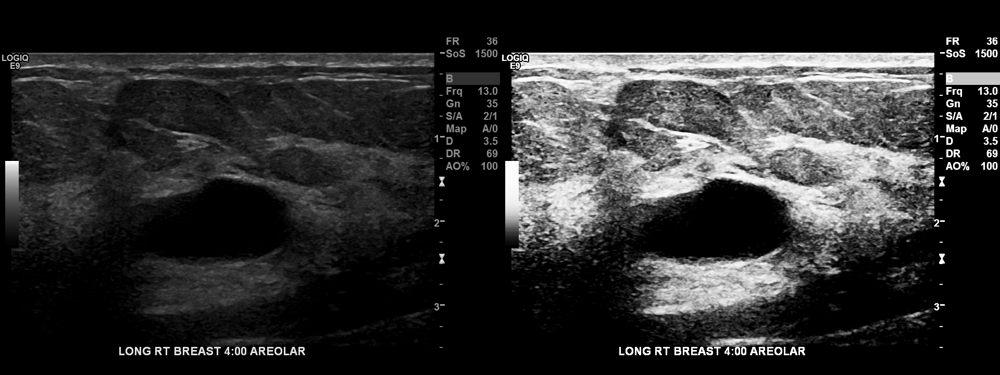

In [ ]:
# img = cv.imread('/content/BUS/MyDrive/BUS/data/train/Benign/000001.png',0)
img = cv.imread('/content/BUS/MyDrive/BUS/new_dataset2/train/benign/image/135379865_long.png',0)
equ = cv.equalizeHist(img)
res = np.hstack((img,equ)) #stacking images side-by-side
cv2_imshow(res);
# cv.imwrite('/content/BUS/MyDrive/BUS/data/train/res.png',equ)

## Image preprocessing - Bilateral filter

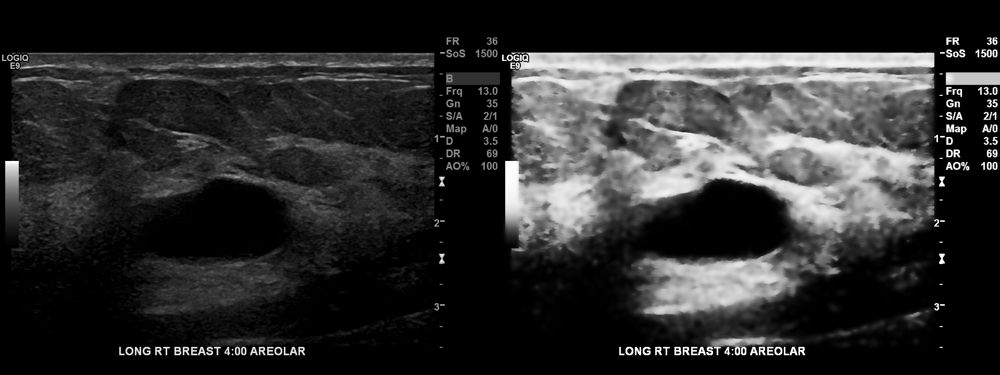

In [ ]:
img = cv.imread('/content/BUS/MyDrive/BUS/new_dataset2/train/benign/image/135379865_long.png',0)
equ = cv.equalizeHist(img)
bil = cv.bilateralFilter(equ, 15, 75, 75)
res = np.hstack((img,bil)) #stacking images side-by-side
cv2_imshow(res);





## Preprocess the mask and image. Split the dataset into test and train.

In [ ]:
! rm -r /content/BUS/MyDrive/BUS/new_dataset2/*

! mkdir /content/BUS/MyDrive/BUS/new_dataset2/msk_class/
! mkdir /content/BUS/MyDrive/BUS/new_dataset2/img_class/

! mkdir /content/BUS/MyDrive/BUS/new_dataset2/msk_class/train/
! mkdir /content/BUS/MyDrive/BUS/new_dataset2/msk_class/train/benign/
! mkdir /content/BUS/MyDrive/BUS/new_dataset2/msk_class/train/malignant/
! mkdir /content/BUS/MyDrive/BUS/new_dataset2/msk_class/test/
! mkdir /content/BUS/MyDrive/BUS/new_dataset2/msk_class/test/benign/
! mkdir /content/BUS/MyDrive/BUS/new_dataset2/msk_class/test/malignant/

! mkdir /content/BUS/MyDrive/BUS/new_dataset2/img_class/train/
! mkdir /content/BUS/MyDrive/BUS/new_dataset2/img_class/train/benign/
! mkdir /content/BUS/MyDrive/BUS/new_dataset2/img_class/train/malignant/
! mkdir /content/BUS/MyDrive/BUS/new_dataset2/img_class/test//
! mkdir /content/BUS/MyDrive/BUS/new_dataset2/img_class/test/benign/
! mkdir /content/BUS/MyDrive/BUS/new_dataset2/img_class/test/malignant/

In [ ]:
df_hist = pd.read_csv('/content/BUS/MyDrive/BUS/new_dataset/annotations_histology_new.csv')

In [ ]:
df_filter = df_hist.query("study_quality in ('good', 'excellent')")

In [ ]:
df_select = df_filter[['external_id', 'best_single_image', 'study_quality', 'pathology', 'predicted_birads', 'predicted_histology']]

In [ ]:
df_select['predicted_histology']

1            NaN
2      malignant
3      malignant
4      malignant
5            NaN
         ...    
156          NaN
157    malignant
158    malignant
159    malignant
160    malignant
Name: predicted_histology, Length: 139, dtype: object

In [ ]:
from pandas._libs.algos import backfill
image_path = '/content/BUS/MyDrive/BUS/new_dataset/all_img/'
mask_path = '/content/BUS/MyDrive/BUS/new_dataset/all_mask/'

for index, row in df_select.iterrows():
    external_id = row['external_id']
    best_single_image = row['best_single_image']
    study_quality = row['study_quality']
    pathology = row['pathology']
    predicted_birads = row['predicted_birads']
    predicted_histology = row['predicted_histology']

    # new_path = 'benign'if pathology == 'Elevated Risk' else str(pathology).lower()
    # new_path2 = new_path if not predicted_histology else str(predicted_histology).lower()

    if best_single_image == 'transverse':
      img_file_name = str(external_id) + '_tran.png'
      mask_file_name = str(external_id) + '_tran_mask.png'
      image_file = image_path + img_file_name
      mask_file = mask_path + mask_file_name

      if not exists(image_file):
          image_file = image_path + str(external_id) + '_long.png'
          mask_file = mask_path + str(external_id) + '_long_mask.png'
    else:
      img_file_name = str(external_id) + '_long.png'
      mask_file_name = str(external_id) + '_long_mask.png'
      image_file = image_path + img_file_name
      mask_file = mask_path + mask_file_name

      if not exists(image_file):
          image_file = image_path + str(external_id) + '_tran.png'
          mask_file = mask_path + str(external_id) + '_tran_mask.png'

    if not exists(image_file):
      continue

    # print(f'best_single_image: {best_single_image}')
    # print(f'image_file: {image_file}')
    # print(f'mask_file: {mask_file}')

    # pre-process the image file
    img = cv.imread(image_file,0)
    equ = cv.equalizeHist(img)
    bil = cv.bilateralFilter(equ, 15, 75, 75) 
    crop_img = bil[100:650, 55:800]

    # pre-process the mask file
    img2 = cv.imread(mask_file,0)
    # equ2 = cv.equalizeHist(img2)
    # bil2 = cv.bilateralFilter(equ2, 15, 75, 75) 
    crop_mask = img2[100:650, 55:800]
    
    if pathology == 'Malignant':    
      # split into train and test dataset
      if np.random.choice(10, 1)[0] < 4:
        cv.imwrite(f'/content/BUS/MyDrive/BUS/new_dataset2/msk_class/test/malignant/{mask_file_name}', crop_mask)
        cv.imwrite(f'/content/BUS/MyDrive/BUS/new_dataset2/img_class/test/malignant/{img_file_name}', crop_img)
      else:
        cv.imwrite(f'/content/BUS/MyDrive/BUS/new_dataset2/msk_class/train/malignant/{mask_file_name}', crop_mask)
        cv.imwrite(f'/content/BUS/MyDrive/BUS/new_dataset2/img_class/train/malignant/{img_file_name}', crop_img)

    else:
      # split into train and test dataset
      if np.random.choice(10, 1)[0] < 4:
        cv.imwrite(f'/content/BUS/MyDrive/BUS/new_dataset2/msk_class/test/benign/{mask_file_name}', crop_mask)
        cv.imwrite(f'/content/BUS/MyDrive/BUS/new_dataset2/img_class/test/benign/{img_file_name}', crop_img)
      else:
        cv.imwrite(f'/content/BUS/MyDrive/BUS/new_dataset2/msk_class/train/benign/{mask_file_name}', crop_mask)
        cv.imwrite(f'/content/BUS/MyDrive/BUS/new_dataset2/img_class/train/benign/{img_file_name}', crop_img)


## Copy the public data set to same directory

In [ ]:
'/content/BUS/MyDrive/BUS/data_mask/Dataset_BUSI_with_GT/train/benign/image/*.png'

In [ ]:
import glob
from os.path import exists
image_names = sorted(glob.glob('/content/BUS/MyDrive/BUS/data_mask/Dataset_BUSI_with_GT/train/benign/image/*.png'))

mask_path = '/content/BUS/MyDrive/BUS/data_mask/Dataset_BUSI_with_GT/train/benign/mask/'

for idx in range(len(image_names)):

  image_filepath = image_names[idx]
  file_name = image_filepath.split('/')[-1]
  mask_file = file_name.split('.')[0] + '_mask.png'
  mask_filepath = mask_path + mask_file

  if exists(image_filepath) and exists(mask_filepath):
    img = cv.imread(image_filepath,0)
    equ = cv.equalizeHist(img)
    bil = cv.bilateralFilter(equ, 15, 75, 75) 
    crop_img = bil

    # pre-process the mask file
    crop_mask = cv.imread(mask_filepath,0)
    
    cv.imwrite(f'/content/BUS/MyDrive/BUS/new_dataset2/msk_class/train/benign/{mask_file}', crop_mask)
    cv.imwrite(f'/content/BUS/MyDrive/BUS/new_dataset2/img_class/train/benign/{file_name}', crop_img)


In [ ]:
import glob
from os.path import exists
image_names = sorted(glob.glob('/content/BUS/MyDrive/BUS/data_mask/Dataset_BUSI_with_GT/train/malignant/image/*.png'))

mask_path = '/content/BUS/MyDrive/BUS/data_mask/Dataset_BUSI_with_GT/train/malignant/mask/'

for idx in range(len(image_names)):

  image_filepath = image_names[idx]
  file_name = image_filepath.split('/')[-1]
  mask_file = file_name.split('.')[0] + '_mask.png'
  mask_filepath = mask_path + mask_file

  if exists(image_filepath) and exists(mask_filepath):
    img = cv.imread(image_filepath,0)
    equ = cv.equalizeHist(img)
    bil = cv.bilateralFilter(equ, 15, 75, 75) 
    crop_img = bil

    # pre-process the mask file
    crop_mask = cv.imread(mask_filepath,0)
    
    cv.imwrite(f'/content/BUS/MyDrive/BUS/new_dataset2/msk_class/train/malignant/{mask_file}', crop_mask)
    cv.imwrite(f'/content/BUS/MyDrive/BUS/new_dataset2/img_class/train/malignant/{file_name}', crop_img)


## Image augmentation

In [ ]:
import glob
from os.path import exists
image_names = sorted(glob.glob('/content/BUS/MyDrive/BUS/new_dataset2/img_class/train/benign/*.png'))

mask_path = '/content/BUS/MyDrive/BUS/new_dataset2/msk_class/train/benign/'

for idx in range(len(image_names)):

  image_filepath = image_names[idx]
  file_name = image_filepath.split('/')[-1]
  mask_file = file_name.split('.')[0] + '_mask.png'
  mask_filepath = mask_path + mask_file

  if exists(image_filepath) and exists(mask_filepath):

    img = cv.imread(image_filepath,0)
    crop_img = cv.flip(img, 1)

    # pre-process the mask file
    mask = cv.imread(mask_filepath,0)
    crop_mask = cv.flip(mask, 1)

    cv.imwrite(f'/content/BUS/MyDrive/BUS/new_dataset2/msk_class/train/benign/ia_{mask_file}', crop_mask)
    cv.imwrite(f'/content/BUS/MyDrive/BUS/new_dataset2/img_class/train/benign/ia_{file_name}', crop_img)


In [ ]:
import glob
from os.path import exists
image_names = sorted(glob.glob('/content/BUS/MyDrive/BUS/new_dataset2/img_class/train/malignant/*.png'))

mask_path = '/content/BUS/MyDrive/BUS/new_dataset2/msk_class/train/malignant/'

for idx in range(len(image_names)):

  image_filepath = image_names[idx]
  file_name = image_filepath.split('/')[-1]
  mask_file = file_name.split('.')[0] + '_mask.png'
  mask_filepath = mask_path + mask_file

  if exists(image_filepath) and exists(mask_filepath):

    img = cv.imread(image_filepath,0)
    crop_img = cv.flip(img, 1)

    # pre-process the mask file
    mask = cv.imread(mask_filepath,0)
    crop_mask = cv.flip(mask, 1)

    cv.imwrite(f'/content/BUS/MyDrive/BUS/new_dataset2/msk_class/train/malignant/ia_{mask_file}', crop_mask)
    cv.imwrite(f'/content/BUS/MyDrive/BUS/new_dataset2/img_class/train/malignant/ia_{file_name}', crop_img)

## Validate few pre-processed images

(550, 745)
(550, 745)


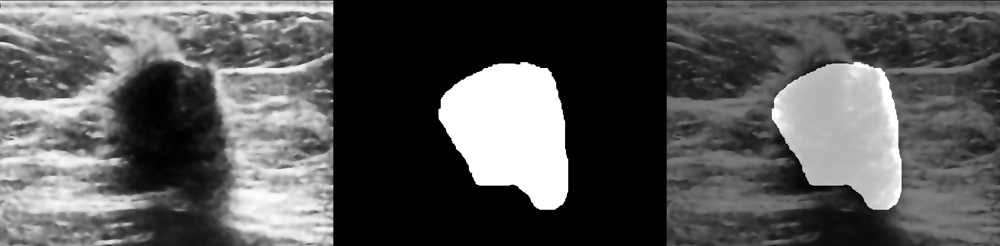

In [ ]:
img = cv.imread('/content/BUS/MyDrive/BUS/new_dataset2/img_class/train/malignant/126590425_tran.png',0)
mask = cv.imread('/content/BUS/MyDrive/BUS/new_dataset2/msk_class/train/malignant/126590425_tran_mask.png',0)

print(img.shape)
print(mask.shape)

overlay = cv.addWeighted(img, 0.5, mask, 0.7, 0)
res = np.hstack((img,mask,overlay)) #stacking images side-by-side
cv2_imshow(res);

(465, 560)
(465, 560)


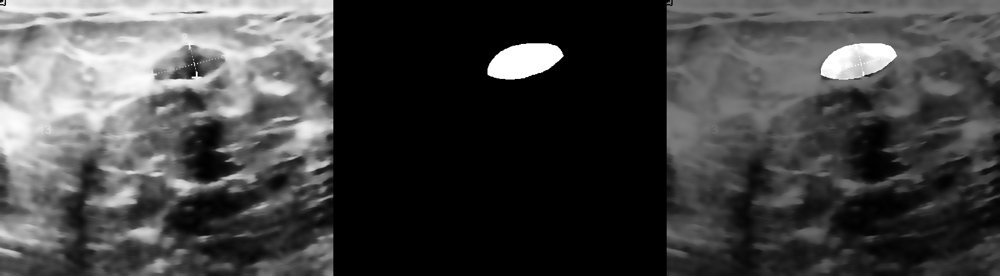

In [ ]:
img = cv.imread('/content/BUS/MyDrive/BUS/new_dataset2/img_class/train/benign/benign (245).png',0)
mask = cv.imread('/content/BUS/MyDrive/BUS/new_dataset2/msk_class/train/benign/benign (245)_mask.png',0)

print(img.shape)
print(mask.shape)

overlay = cv.addWeighted(img, 0.5, mask, 0.7, 0)
res = np.hstack((img,mask,overlay)) #stacking images side-by-side
cv2_imshow(res);

(465, 560)
(465, 560)


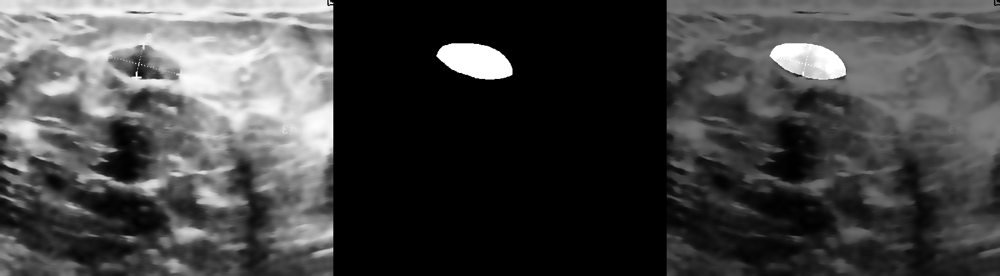

In [ ]:
cv.flip(img, 1)


img = cv.imread('/content/BUS/MyDrive/BUS/new_dataset2/img_class/train/benign/benign (245).png',0)
mask = cv.imread('/content/BUS/MyDrive/BUS/new_dataset2/msk_class/train/benign/benign (245)_mask.png',0)

img = cv.flip(img, 1)
mask = cv.flip(mask, 1)

print(img.shape)
print(mask.shape)

overlay = cv.addWeighted(img, 0.5, mask, 0.7, 0)
res = np.hstack((img,mask,overlay)) #stacking images side-by-side
cv2_imshow(res);




(550, 745)
(550, 745)


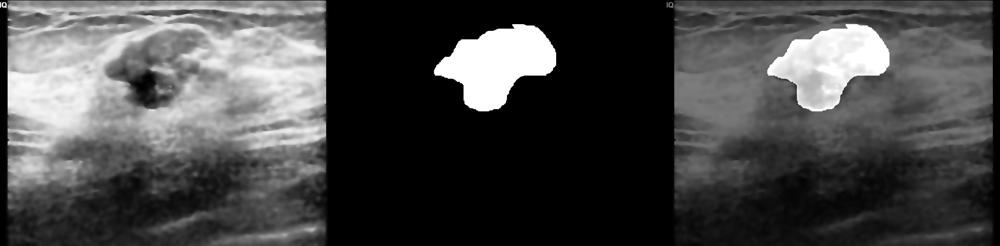

In [ ]:
img = cv.imread('/content/BUS/MyDrive/BUS/new_dataset2/img_class/test/benign/113014078_long.png',0)
mask = cv.imread('/content/BUS/MyDrive/BUS/new_dataset2/msk_class/test/benign/113014078_long_mask.png',0)

print(img.shape)
print(mask.shape)
overlay = cv.addWeighted(img, 0.5, mask, 0.7, 0)
res = np.hstack((img,mask,overlay)) #stacking images side-by-side
cv2_imshow(res);

(469, 564)
(469, 564)


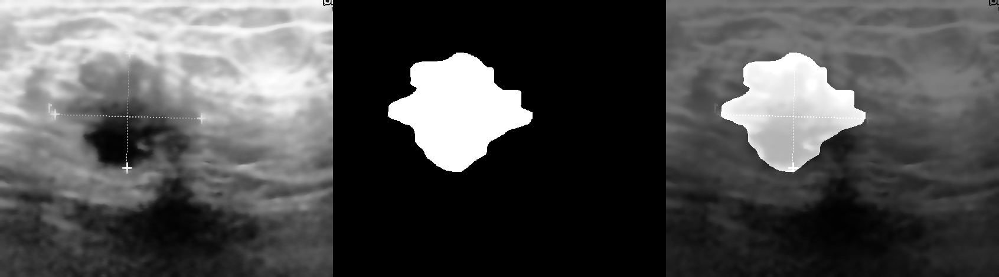

In [ ]:
img = cv.imread('/content/BUS/MyDrive/BUS/new_dataset2/img_class/train/malignant/ia_malignant (119).png',0)
mask = cv.imread('/content/BUS/MyDrive/BUS/new_dataset2/msk_class/train/malignant/ia_malignant (119)_mask.png',0)


print(img.shape)
print(mask.shape)
overlay = cv.addWeighted(img, 0.5, mask, 0.7, 0)
res = np.hstack((img,mask,overlay)) #stacking images side-by-side
cv2_imshow(res);

# Segmentation model

### Create directories

In [ ]:
! mkdir /content/BUS/MyDrive/BUS/new_dataset2/segmentation
! mkdir /content/BUS/MyDrive/BUS/new_dataset2/segmentation/train/
! mkdir /content/BUS/MyDrive/BUS/new_dataset2/segmentation/train/image/
! mkdir /content/BUS/MyDrive/BUS/new_dataset2/segmentation/train/mask/

! mkdir /content/BUS/MyDrive/BUS/new_dataset2/segmentation/test/
! mkdir /content/BUS/MyDrive/BUS/new_dataset2/segmentation/test/image/
! mkdir /content/BUS/MyDrive/BUS/new_dataset2/segmentation/test/mask/

# Copy the mask
! cp -r /content/BUS/MyDrive/BUS/new_dataset2/msk_class/train/benign/*  /content/BUS/MyDrive/BUS/new_dataset2/segmentation/train/mask/
! cp -r /content/BUS/MyDrive/BUS/new_dataset2/msk_class/train/malignant/*  /content/BUS/MyDrive/BUS/new_dataset2/segmentation/train/mask/
! cp -r /content/BUS/MyDrive/BUS/new_dataset2/msk_class/test/benign/*  /content/BUS/MyDrive/BUS/new_dataset2/segmentation/test/mask/
! cp -r /content/BUS/MyDrive/BUS/new_dataset2/msk_class/test/malignant/*  /content/BUS/MyDrive/BUS/new_dataset2/segmentation/test/mask/

# Copy the images
! cp -r /content/BUS/MyDrive/BUS/new_dataset2/img_class/train/benign/*  /content/BUS/MyDrive/BUS/new_dataset2/segmentation/train/image/
! cp -r /content/BUS/MyDrive/BUS/new_dataset2/img_class/train/malignant/*  /content/BUS/MyDrive/BUS/new_dataset2/segmentation/train/image/
! cp -r /content/BUS/MyDrive/BUS/new_dataset2/img_class/test/benign/*  /content/BUS/MyDrive/BUS/new_dataset2/segmentation/test/image/
! cp -r /content/BUS/MyDrive/BUS/new_dataset2/img_class/test/malignant/*  /content/BUS/MyDrive/BUS/new_dataset2/segmentation/test/image/


## Define Tumor dataset

In [ ]:
import os
import numpy as np
import torch
from PIL import Image


class TumorDataset(object):
    def __init__(self, root, transforms=None, label=None):
        self.root = root
        self.transforms = transforms
        # load all image files, sorting them to
        # ensure that they are aligned
        self.imgs = list(sorted(os.listdir(os.path.join(root, "image"))))
        self.masks = list(sorted(os.listdir(os.path.join(root, "mask"))))
        self.label = label

    def center_crop(self, img):
        # center crop the image
        center_transform = transforms.Compose([
                                     transforms.RandomEqualize(),
                                     transforms.Resize(size=256),
                                     transforms.CenterCrop(size=200),
                                     transforms.ToTensor()])
        
        center_image = center_transform(img)
        
        # Convert tensor to image
        transform = transforms.ToPILImage()
        final_image = transform(center_image)

        return final_image


    def __getitem__(self, idx):
        # load images and masks
        img_path = os.path.join(self.root, "image", self.imgs[idx])
        mask_path = os.path.join(self.root, "mask", self.masks[idx])
        img = Image.open(img_path).convert("RGB")

        # Apply histogram equalization and bilateral filter.
        # raw_img = cv.imread(img_path,0)
        # hist_img = cv.equalizeHist(raw_img)
        # bil = cv.bilateralFilter(hist_img, 15, 75, 75)
        # img = Image.fromarray(np.uint8(cm.gray(hist_img)*255))
        # img = Image.fromarray(bil.astype('uint8'), 'RGB')

        # note that we haven't converted the mask to RGB,
        # because each color corresponds to a different instance
        # with 0 being background
        mask = Image.open(mask_path)

        # Center crop both image and mask
        # img = self.center_crop(img)
        # mask = self.center_crop(mask)

        # convert the PIL Image into a numpy array
        mask = np.array(mask)
        # instances are encoded as different colors
        obj_ids = np.unique(mask)
        # first id is the background, so remove it
        obj_ids = obj_ids[1:]

        # split the color-encoded mask into a set
        # of binary masks
        masks = mask == obj_ids[:, None, None]

        # get bounding box coordinates for each mask
        num_objs = len(obj_ids)
        boxes = []
        # My experiment-
        # # for i in range(num_objs):
        # pos = np.where(masks==True)
        # xmin = np.min(pos[1])
        # xmax = np.max(pos[1])
        # ymin = np.min(pos[0])
        # ymax = np.max(pos[0])
        # boxes.append([xmin, ymin, xmax, ymax])

        for i in range(num_objs):
            pos = np.where(masks[i])
            xmin = np.min(pos[1])
            xmax = np.max(pos[1])
            ymin = np.min(pos[0])
            ymax = np.max(pos[0])
            boxes.append([xmin, ymin, xmax, ymax])

        # convert everything into a torch.Tensor
        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        # there is only one class
        # if self.label == "benign":
        #   # labels = torch.as_tensor(1, dtype=torch.int64)
        #   labels = torch.as_tensor([1,0],dtype=torch.int64)
        #   # labels = torch.ones((1,), dtype=torch.int64)
        # elif self.label == "malignant":
        #   # labels = torch.as_tensor(2, dtype=torch.int64)
        #   labels = torch.as_tensor([1,1],dtype=torch.int64)
        #   # labels = torch.ones((2,), dtype=torch.int64)


        labels = torch.ones((num_objs,), dtype=torch.int64)
        # labels = torch.tensor(lst)
        # labels = torch.ones((self.label,), dtype=torch.int64)
        masks = torch.as_tensor(masks, dtype=torch.uint8)

        image_id = torch.tensor([idx])
        area = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0])
        
        # suppose all instances are not crowd
        iscrowd = torch.zeros((num_objs,), dtype=torch.int64)

        target = {}
        target["boxes"] = boxes
        target["labels"] = labels
        target["masks"] = masks
        target["image_id"] = image_id
        target["area"] = area
        target["iscrowd"] = iscrowd
        # target['image_path'] = img_path
        # target['mask_path'] = mask_path

        if self.transforms is not None:
            img, target = self.transforms(img, target)

        return img, target

    def __len__(self):
        return len(self.imgs)

In [ ]:
train_path = '/content/BUS/MyDrive/BUS/new_dataset2/segmentation/train/'
dataset = TumorDataset(train_path, None, 'benign')
dataset[0]

(<PIL.Image.Image image mode=RGB size=745x550 at 0x7F31D8AB4D50>,
 {'area': tensor([48440.]),
  'boxes': tensor([[227., 165., 507., 338.]]),
  'image_id': tensor([0]),
  'iscrowd': tensor([0]),
  'labels': tensor([1]),
  'masks': tensor([[[0, 0, 0,  ..., 0, 0, 0],
           [0, 0, 0,  ..., 0, 0, 0],
           [0, 0, 0,  ..., 0, 0, 0],
           ...,
           [0, 0, 0,  ..., 0, 0, 0],
           [0, 0, 0,  ..., 0, 0, 0],
           [0, 0, 0,  ..., 0, 0, 0]]], dtype=torch.uint8)})

## Define the segmentation model

In [ ]:
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection.mask_rcnn import MaskRCNNPredictor

      
def get_instance_segmentation_model(num_classes):
    # load an instance segmentation model pre-trained on COCO
    model = torchvision.models.detection.maskrcnn_resnet50_fpn(pretrained=True)

    # get the number of input features for the classifier
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    # replace the pre-trained head with a new one
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

    # now get the number of input features for the mask classifier
    in_features_mask = model.roi_heads.mask_predictor.conv5_mask.in_channels
    hidden_layer = 256
    # and replace the mask predictor with a new one
    model.roi_heads.mask_predictor = MaskRCNNPredictor(in_features_mask,
                                                       hidden_layer,
                                                       num_classes)

    return model

In [ ]:
%%shell

# Download TorchVision repo to use some files from
# references/detection
git clone https://github.com/pytorch/vision.git
cd vision
git checkout v0.8.2

cp references/detection/utils.py ../
cp references/detection/transforms.py ../
cp references/detection/coco_eval.py ../
cp references/detection/engine.py ../
cp references/detection/coco_utils.py ../

Cloning into 'vision'...
remote: Enumerating objects: 125446, done.
remote: Counting objects: 100% (482/482), done.
remote: Compressing objects: 100% (434/434), done.
remote: Total 125446 (delta 430), reused 77 (delta 45), pack-reused 124964
Receiving objects: 100% (125446/125446), 247.51 MiB | 40.55 MiB/s, done.
Resolving deltas: 100% (109545/109545), done.
Note: checking out 'v0.8.2'.

You are in 'detached HEAD' state. You can look around, make experimental
changes and commit them, and you can discard any commits you make in this
state without impacting any branches by performing another checkout.

If you want to create a new branch to retain commits you create, you may
do so (now or later) by using -b with the checkout command again. Example:

  git checkout -b <new-branch-name>

HEAD is now at 2f40a483d [v0.8.X] .circleci: Add Python 3.9 to CI (#3063)


## Define the transformation for training

In [ ]:
from engine import train_one_epoch, evaluate
import utils
import transforms as T

def get_transform(train):
    transforms = []
    # converts the image, a PIL image, into a PyTorch Tensor
    transforms.append(T.ToTensor())
    if train:
        # during training, randomly flip the training images
        # and ground-truth for data augmentation
        transforms.append(T.RandomHorizontalFlip(0.5))
    return T.Compose(transforms)

## Define dataset and data loader

In [ ]:
from engine import train_one_epoch, evaluate
import utils

# def main():
# train on the GPU or on the CPU, if a GPU is not available
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

# our dataset has two classes only - background and person
num_classes = 3
# use our dataset and defined transformations
# use our dataset and defined transformations
train_path = '/content/BUS/MyDrive/BUS/new_dataset2/segmentation/train/'
test_path = '/content/BUS/MyDrive/BUS/new_dataset2/segmentation/test/'

dataset = TumorDataset(train_path, get_transform(train=True))
dataset_test = TumorDataset(test_path, get_transform(train=False))

# split the dataset in train and test set
# indices = torch.randperm(len(dataset)).tolist()
# dataset = torch.utils.data.Subset(dataset, indices[:-20])
# dataset_test = torch.utils.data.Subset(dataset, indices[-20:])

# define training and validation data loaders
data_loader = torch.utils.data.DataLoader(
    dataset, batch_size=2, shuffle=True, num_workers=4,
    collate_fn=utils.collate_fn)

data_loader_test = torch.utils.data.DataLoader(
    dataset_test, batch_size=1, shuffle=False, num_workers=4,
    collate_fn=utils.collate_fn)

## Define the model parameters and Optimizer

In [ ]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

# our dataset has two classes only - background and person
num_classes = 3

# get the model using our helper function
model = get_instance_segmentation_model(num_classes)
# move model to the right device
model.to(device)

# construct an optimizer
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.005,
                            momentum=0.9, weight_decay=0.0005)

# and a learning rate scheduler which decreases the learning rate by
# 10x every 3 epochs
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer,
                                               step_size=3,
                                               gamma=0.1)

Downloading: "https://download.pytorch.org/models/maskrcnn_resnet50_fpn_coco-bf2d0c1e.pth" to /root/.cache/torch/hub/checkpoints/maskrcnn_resnet50_fpn_coco-bf2d0c1e.pth


  0%|          | 0.00/170M [00:00<?, ?B/s]

## Train the model and save checkpoints

In [ ]:
from torch.optim.lr_scheduler import StepLR
from datetime import datetime
num_epochs = 10

for epoch in range(num_epochs):
    # train for one epoch, printing every 10 iterations
    train_one_epoch(model, optimizer, data_loader, device, epoch, print_freq=10)
    # update the learning rate
    lr_scheduler.step()
    # evaluate on the test dataset
    evaluate(model, data_loader_test, device=device)

print(f'Saving the model parameter')
str_ts = datetime.strftime(datetime.now(), '%Y%m%d%H%M')
checkpoint = {'model_state': model.state_dict(), 
              'optimizer_state': optimizer.state_dict()}

torch.save(checkpoint, f'/content/BUS/MyDrive/BUS/checkpoint/mrcnn_checkpoint1_epoch_{str_ts}.pt')

Epoch: [0]  [  0/756]  eta: 0:07:54  lr: 0.000012  loss: 0.3997 (0.3997)  loss_classifier: 0.0740 (0.0740)  loss_box_reg: 0.0690 (0.0690)  loss_mask: 0.2537 (0.2537)  loss_objectness: 0.0010 (0.0010)  loss_rpn_box_reg: 0.0020 (0.0020)  time: 0.6282  data: 0.2805  max mem: 3641
Epoch: [0]  [ 10/756]  eta: 0:04:17  lr: 0.000078  loss: 0.3285 (0.3646)  loss_classifier: 0.0408 (0.0513)  loss_box_reg: 0.0646 (0.0662)  loss_mask: 0.2167 (0.2428)  loss_objectness: 0.0017 (0.0025)  loss_rpn_box_reg: 0.0017 (0.0018)  time: 0.3445  data: 0.0326  max mem: 3641
Epoch: [0]  [ 20/756]  eta: 0:04:09  lr: 0.000144  loss: 0.3285 (0.3923)  loss_classifier: 0.0408 (0.0520)  loss_box_reg: 0.0548 (0.0632)  loss_mask: 0.2167 (0.2726)  loss_objectness: 0.0022 (0.0026)  loss_rpn_box_reg: 0.0014 (0.0020)  time: 0.3244  data: 0.0081  max mem: 3641
Epoch: [0]  [ 30/756]  eta: 0:04:04  lr: 0.000210  loss: 0.3135 (0.3715)  loss_classifier: 0.0389 (0.0490)  loss_box_reg: 0.0584 (0.0627)  loss_mask: 0.2058 (0.2541) 

In [ ]:
def iou(pred, target, n_classes = 3):
  ious = []
  pred = pred.view(-1)
  target = target.view(-1)

  # Ignore IoU for background class ("0")
  for cls in xrange(1, n_classes):  # This goes from 1:n_classes-1 -> class "0" is ignored
    pred_inds = pred == cls
    target_inds = target == cls
    intersection = (pred_inds[target_inds]).long().sum().data.cpu()[0]  # Cast to long to prevent overflows
    union = pred_inds.long().sum().data.cpu()[0] + target_inds.long().sum().data.cpu()[0] - intersection
    if union == 0:
      ious.append(float('nan'))  # If there is no ground truth, do not include in evaluation
    else:
      ious.append(float(intersection) / float(max(union, 1)))
  return np.array(ious)

In [ ]:
# from past.builtins import xrange
# # from torchmetrics import IoU
# target = torch.randint(0, 2, (10, 25, 25))
# pred = torch.tensor(target)
# pred[2:5, 7:13, 9:15] = 1 - pred[2:5, 7:13, 9:15]
# # iou = IoU(num_classes=2)
# iou(pred, target)

In [ ]:
pip install torchmetrics

     |████████████████████████████████| 408 kB 5.0 MB/s 


## Validate segmentation model

<Figure size 14400x7200 with 0 Axes>

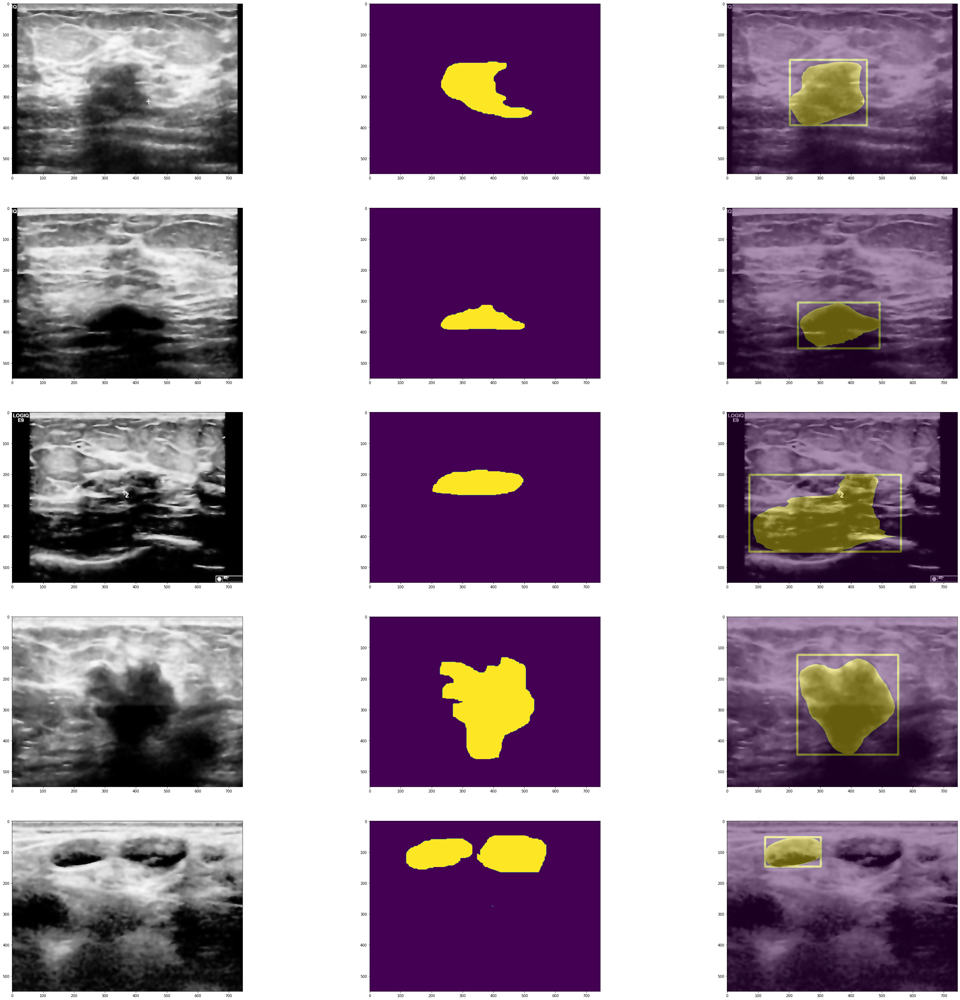

In [ ]:
import glob
import os
import shutil

from PIL import Image
from matplotlib import cm
# from torchmetrics import IoU

# iou = IoU(num_classes=2)

plt.figure(figsize=(200, 100)) 
f, axarr = plt.subplots(5,3, figsize=(50,50))

font                   = cv.FONT_HERSHEY_SIMPLEX
bottomLeftCornerOfText = (10,500)
fontScale              = 1
fontColor              = (255,255,255)
thickness              = 1
lineType               = 2

# model_state = torch.load('/content/BUS/MyDrive/BUS/checkpoint/mrcnn_checkpoint1_epoch_202204031142.pt')['model_state']
# model_state = torch.load('/content/BUS/MyDrive/BUS/checkpoint/mrcnn_checkpoint2_epoch_202204070028.pt')['model_state']
# model.load_state_dict(model_state, strict=True)

image_names = sorted(glob.glob('/content/BUS/MyDrive/BUS/new_dataset2/segmentation/test/mask/*.png'))

for idx, iidx in enumerate(range(0,5)):

  gt_mask = cv.imread(image_names[iidx],0)

  img, mask = dataset_test[iidx]
  # put the model in evaluation mode
  model.eval()
  with torch.no_grad():
      prediction = model([img.to(device)])

  # print(img)
  img2 = Image.fromarray(img.mul(255).permute(1, 2, 0).byte().numpy())
  # img2 = Image.fromarray(img.permute(1, 2, 0).byte().numpy())
  gt_mask2 = Image.fromarray(gt_mask)
  # np_mask = prediction[0]['masks'][0, 0].mul(255).byte().cpu().numpy()
  # np_mask = (prediction[0]['masks'][0, 0]>0.5).squeeze().detach().cpu().numpy()
  np_mask = (prediction[0]['masks'][0, 0]>0.5).mul(255).byte().cpu().numpy()
  x1 = int(prediction[0]['boxes'][0][0])
  y1 = int(prediction[0]['boxes'][0][1])
  x2 = int(prediction[0]['boxes'][0][2])
  y2 = int(prediction[0]['boxes'][0][3])


  pred = torch.from_numpy(np_mask)
  target = torch.from_numpy(gt_mask)
  
  # iou_score = iou(pred, target)

  
  box = cv.rectangle(np_mask,(x1,y1),(x2,y2),(255,0,0),5)
  mask2 = Image.fromarray(box)
  # mask3 = cv.putText(mask2 ,iou_score, (x1, y1), font, fontScale, fontColor, thickness,lineType)
  



  axarr[idx, 0].imshow(img2)
  axarr[idx, 1].imshow(gt_mask2)
  axarr[idx, 2].imshow(img2)
  axarr[idx, 2].imshow(mask2, alpha=0.4)



<Figure size 14400x7200 with 0 Axes>

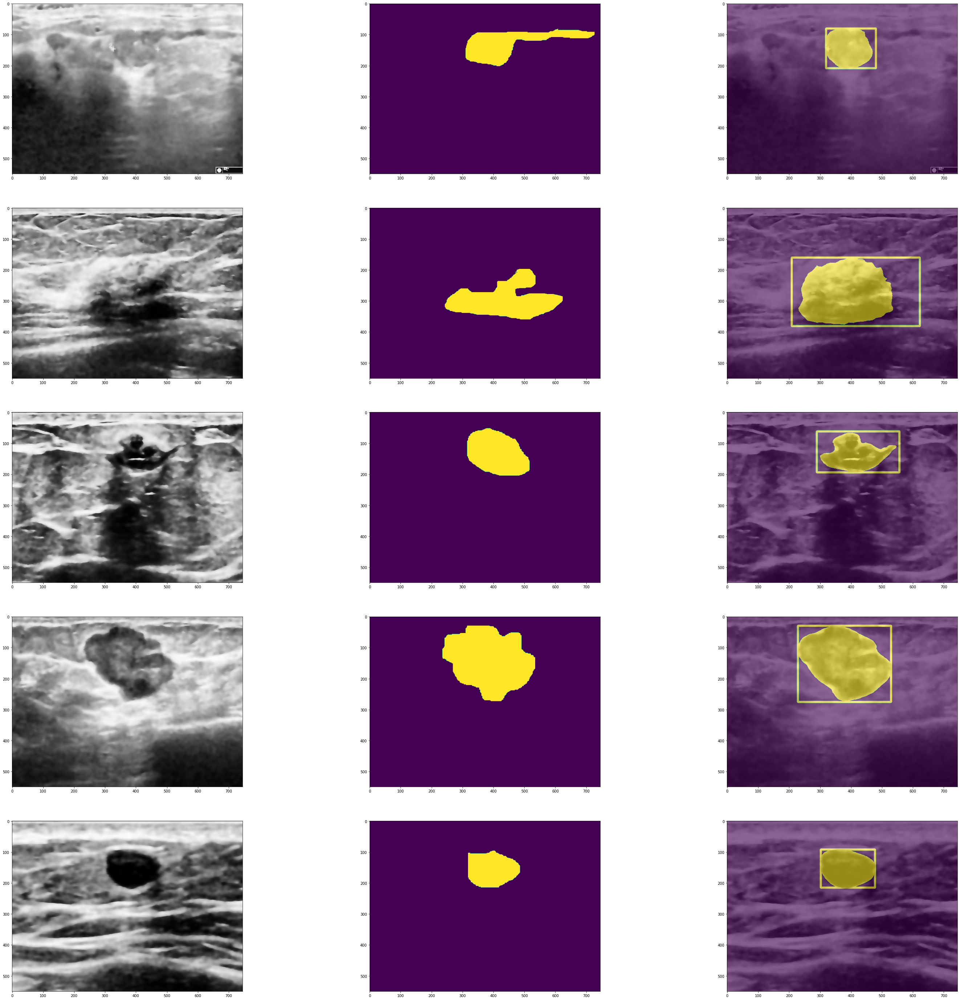

In [ ]:
plt.figure(figsize=(200, 100)) 
f, axarr = plt.subplots(5,3, figsize=(50,50))


image_names = sorted(glob.glob('/content/BUS/MyDrive/BUS/new_dataset2/segmentation/test/mask/*.png'))

for idx, iidx in enumerate(range(5,10)):

  # print(image_names[iidx])
  gt_mask = cv.imread(image_names[iidx],0)

  img, mask = dataset_test[iidx]
  # put the model in evaluation mode
  model.eval()
  with torch.no_grad():
      prediction = model([img.to(device)])

  # print(prediction)
  img2 = Image.fromarray(img.mul(255).permute(1, 2, 0).byte().numpy())
  gt_mask = Image.fromarray(gt_mask)
  # np_mask = prediction[0]['masks'][0, 0].mul(255).byte().cpu().numpy()
  np_mask = (prediction[0]['masks'][0, 0]>0.5).mul(255).byte().cpu().numpy()

  x1 = int(prediction[0]['boxes'][0][0])
  y1 = int(prediction[0]['boxes'][0][1])
  x2 = int(prediction[0]['boxes'][0][2])
  y2 = int(prediction[0]['boxes'][0][3])
  box = cv.rectangle(np_mask,(x1,y1),(x2,y2),(255,0,0),5)
  mask2 = Image.fromarray(box)


  axarr[idx, 0].imshow(img2)
  axarr[idx, 1].imshow(gt_mask)
  axarr[idx, 2].imshow(img2)
  axarr[idx, 2].imshow(mask2, alpha=0.6)

IndexError: ignored

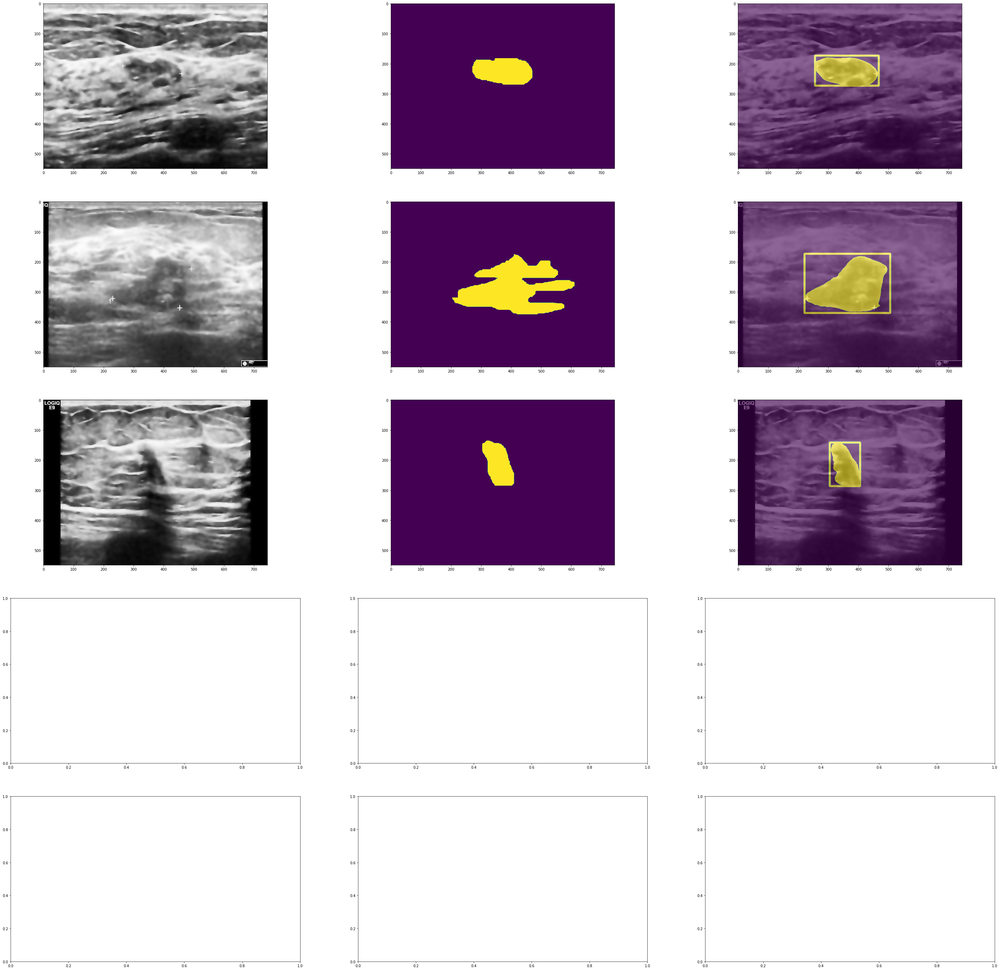

In [ ]:
# plt.figure(figsize=(200, 100)) 
f, axarr = plt.subplots(5,3, figsize=(50,50))


image_names = sorted(glob.glob('/content/BUS/MyDrive/BUS/new_dataset2/segmentation/test/mask/*.png'))

for idx, iidx in enumerate(range(10,15)):

  gt_mask = cv.imread(image_names[iidx],0)

  img, mask = dataset_test[iidx]
  # put the model in evaluation mode
  model.eval()
  with torch.no_grad():
      prediction = model([img.to(device)])

  img2 = Image.fromarray(img.mul(255).permute(1, 2, 0).byte().numpy())
  gt_mask = Image.fromarray(gt_mask)
  # np_mask = prediction[0]['masks'][0, 0].mul(255).byte().cpu().numpy()
  np_mask = (prediction[0]['masks'][0, 0]>0.5).mul(255).byte().cpu().numpy()
  x1 = int(prediction[0]['boxes'][0][0])
  y1 = int(prediction[0]['boxes'][0][1])
  x2 = int(prediction[0]['boxes'][0][2])
  y2 = int(prediction[0]['boxes'][0][3])
  box = cv.rectangle(np_mask,(x1,y1),(x2,y2),(255,0,0),5)
  mask2 = Image.fromarray(box)


  axarr[idx, 0].imshow(img2)
  axarr[idx, 1].imshow(gt_mask)
  axarr[idx, 2].imshow(img2)
  axarr[idx, 2].imshow(mask2, alpha=0.6)

<Figure size 14400x7200 with 0 Axes>

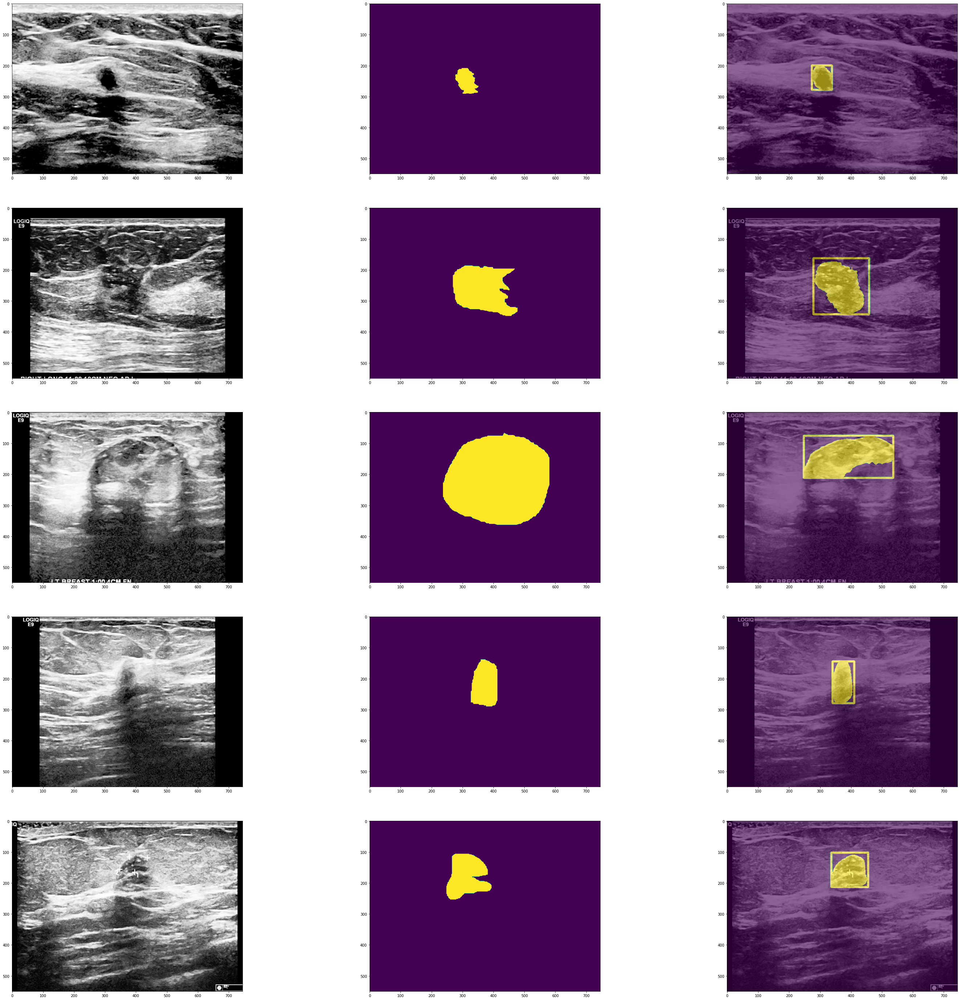

In [ ]:
plt.figure(figsize=(200, 100)) 
f, axarr = plt.subplots(5,3, figsize=(50,50))


image_names = sorted(glob.glob('/content/BUS/MyDrive/BUS/new_dataset2/segmentation/test/mask/*.png'))

for idx, iidx in enumerate(range(15,20)):

  gt_mask = cv.imread(image_names[iidx],0)

  img, mask = dataset_test[iidx]
  # put the model in evaluation mode
  model.eval()
  with torch.no_grad():
      prediction = model([img.to(device)])

  img2 = Image.fromarray(img.mul(255).permute(1, 2, 0).byte().numpy())
  gt_mask = Image.fromarray(gt_mask)
  # np_mask = prediction[0]['masks'][0, 0].mul(255).byte().cpu().numpy()
  np_mask = (prediction[0]['masks'][0, 0]>0.5).mul(255).byte().cpu().numpy()
  x1 = int(prediction[0]['boxes'][0][0])
  y1 = int(prediction[0]['boxes'][0][1])
  x2 = int(prediction[0]['boxes'][0][2])
  y2 = int(prediction[0]['boxes'][0][3])
  box = cv.rectangle(np_mask,(x1,y1),(x2,y2),(255,0,0),5)
  mask2 = Image.fromarray(box)


  axarr[idx, 0].imshow(img2)
  axarr[idx, 1].imshow(gt_mask)
  axarr[idx, 2].imshow(img2)
  axarr[idx, 2].imshow(mask2, alpha=0.6)

<Figure size 14400x7200 with 0 Axes>

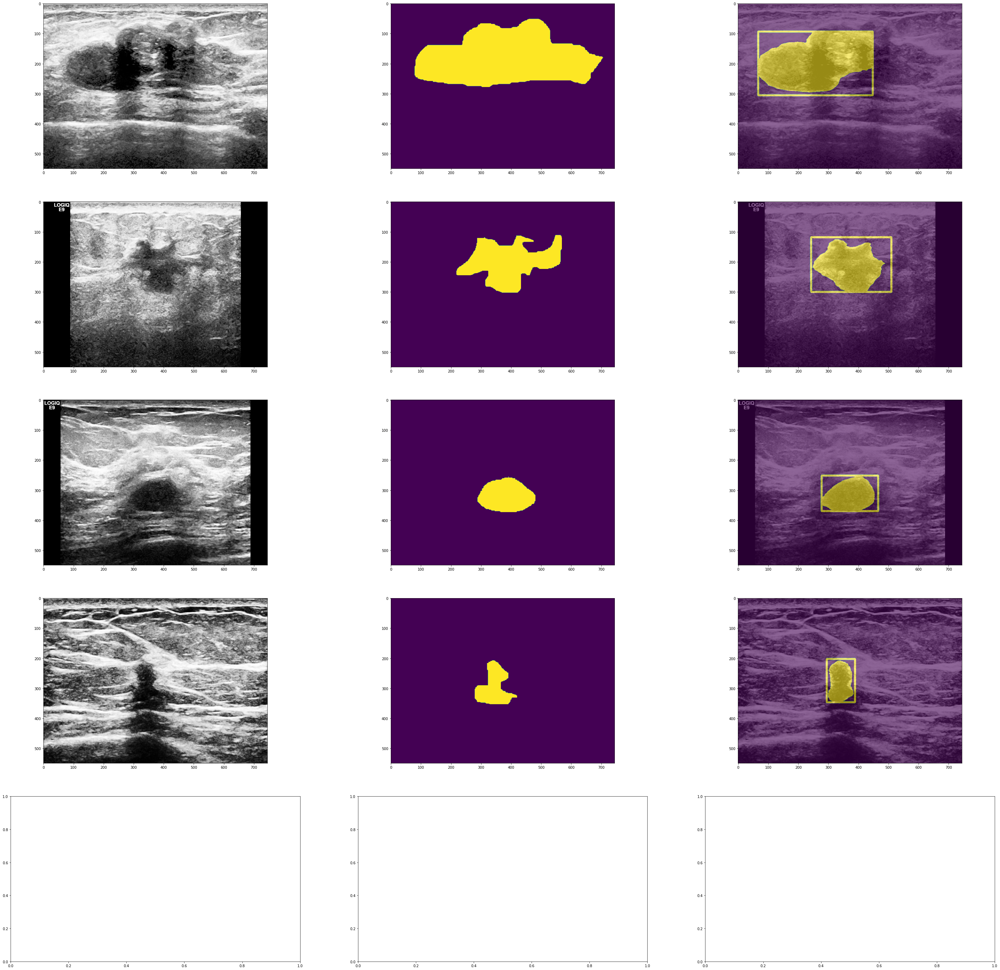

In [ ]:
plt.figure(figsize=(200, 100)) 
f, axarr = plt.subplots(5,3, figsize=(50,50))


image_names = sorted(glob.glob('/content/BUS/MyDrive/BUS/new_dataset2/segmentation/test/mask/*.png'))

for idx, iidx in enumerate(range(21,25)):

  gt_mask = cv.imread(image_names[iidx],0)

  img, mask = dataset_test[iidx]
  # put the model in evaluation mode
  model.eval()
  with torch.no_grad():
      prediction = model([img.to(device)])

  img2 = Image.fromarray(img.mul(255).permute(1, 2, 0).byte().numpy())
  gt_mask = Image.fromarray(gt_mask)
  # np_mask = prediction[0]['masks'][0, 0].mul(255).byte().cpu().numpy()
  np_mask = (prediction[0]['masks'][0, 0]>0.5).mul(255).byte().cpu().numpy()
  x1 = int(prediction[0]['boxes'][0][0])
  y1 = int(prediction[0]['boxes'][0][1])
  x2 = int(prediction[0]['boxes'][0][2])
  y2 = int(prediction[0]['boxes'][0][3])
  box = cv.rectangle(np_mask,(x1,y1),(x2,y2),(255,0,0),5)
  mask2 = Image.fromarray(box)


  axarr[idx, 0].imshow(img2)
  axarr[idx, 1].imshow(gt_mask)
  axarr[idx, 2].imshow(img2)
  axarr[idx, 2].imshow(mask2, alpha=0.6)

<Figure size 14400x7200 with 0 Axes>

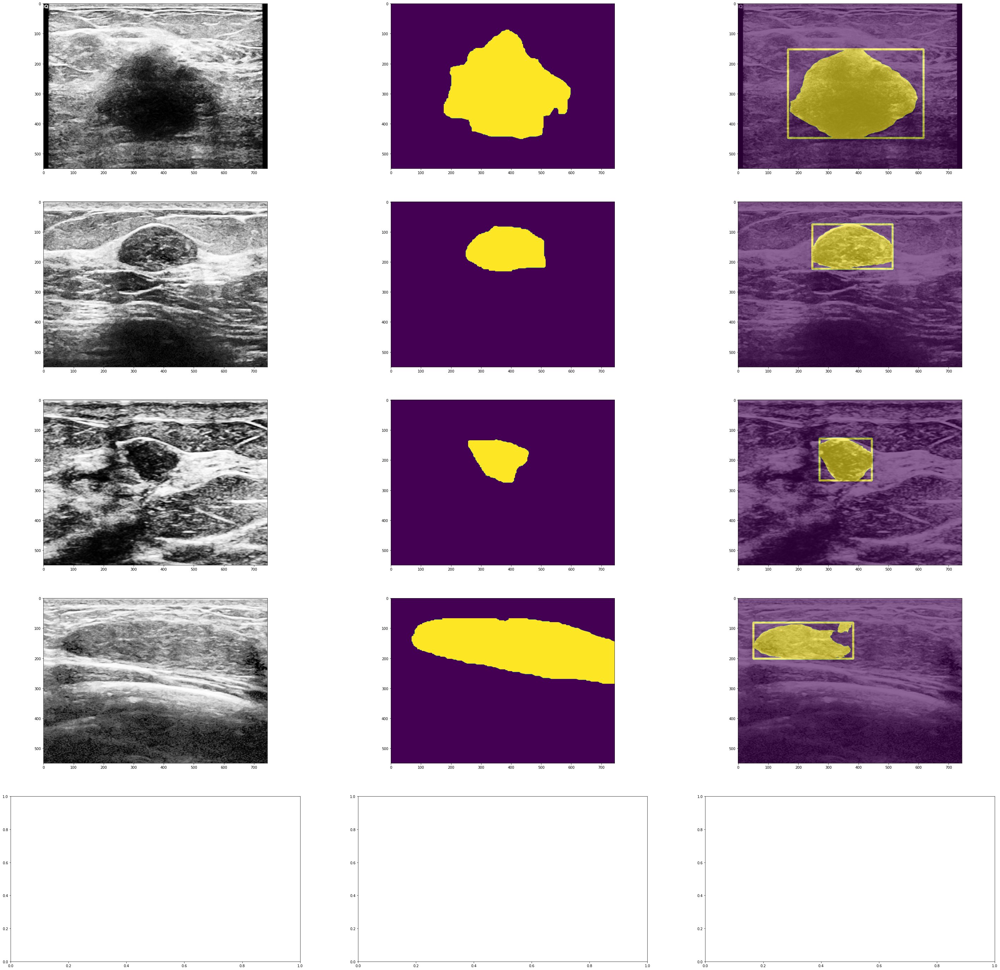

In [ ]:
plt.figure(figsize=(200, 100)) 
f, axarr = plt.subplots(5,3, figsize=(50,50))


image_names = sorted(glob.glob('/content/BUS/MyDrive/BUS/new_dataset2/segmentation/test/mask/*.png'))

for idx, iidx in enumerate(range(26,30)):

  gt_mask = cv.imread(image_names[iidx],0)

  img, mask = dataset_test[iidx]
  # put the model in evaluation mode
  model.eval()
  with torch.no_grad():
      prediction = model([img.to(device)])

  img2 = Image.fromarray(img.mul(255).permute(1, 2, 0).byte().numpy())
  gt_mask = Image.fromarray(gt_mask)
  # np_mask = prediction[0]['masks'][0, 0].mul(255).byte().cpu().numpy()
  np_mask = (prediction[0]['masks'][0, 0]>0.5).mul(255).byte().cpu().numpy()
  x1 = int(prediction[0]['boxes'][0][0])
  y1 = int(prediction[0]['boxes'][0][1])
  x2 = int(prediction[0]['boxes'][0][2])
  y2 = int(prediction[0]['boxes'][0][3])
  box = cv.rectangle(np_mask,(x1,y1),(x2,y2),(255,0,0),5)
  mask2 = Image.fromarray(box)


  axarr[idx, 0].imshow(img2)
  axarr[idx, 1].imshow(gt_mask)
  axarr[idx, 2].imshow(img2)
  axarr[idx, 2].imshow(mask2, alpha=0.6)

<Figure size 14400x7200 with 0 Axes>

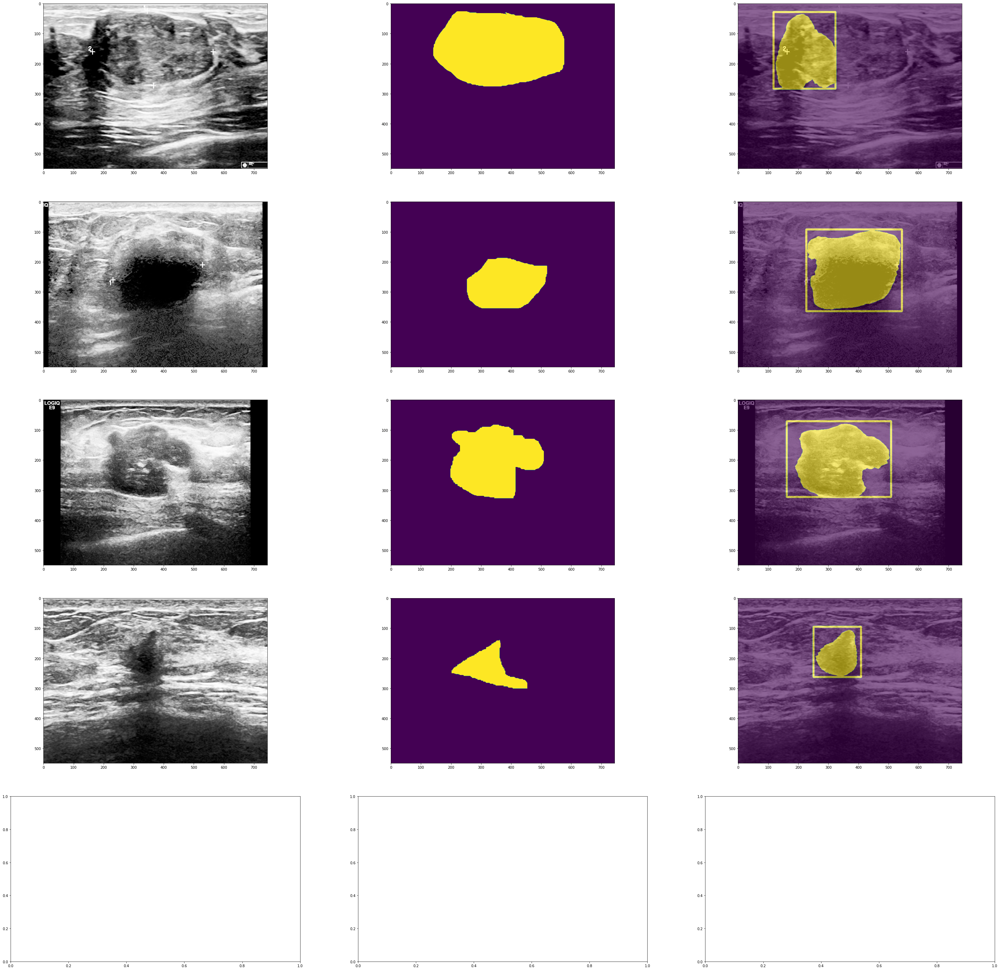

In [ ]:
plt.figure(figsize=(200, 100)) 
f, axarr = plt.subplots(5,3, figsize=(50,50))


image_names = sorted(glob.glob('/content/BUS/MyDrive/BUS/new_dataset2/segmentation/test/mask/*.png'))

for idx, iidx in enumerate(range(31,35)):

  gt_mask = cv.imread(image_names[iidx],0)

  img, mask = dataset_test[iidx]
  # put the model in evaluation mode
  model.eval()
  with torch.no_grad():
      prediction = model([img.to(device)])

  img2 = Image.fromarray(img.mul(255).permute(1, 2, 0).byte().numpy())
  gt_mask = Image.fromarray(gt_mask)
  # np_mask = prediction[0]['masks'][0, 0].mul(255).byte().cpu().numpy()
  np_mask = (prediction[0]['masks'][0, 0]>0.5).mul(255).byte().cpu().numpy()
  x1 = int(prediction[0]['boxes'][0][0])
  y1 = int(prediction[0]['boxes'][0][1])
  x2 = int(prediction[0]['boxes'][0][2])
  y2 = int(prediction[0]['boxes'][0][3])
  box = cv.rectangle(np_mask,(x1,y1),(x2,y2),(255,0,0),5)
  mask2 = Image.fromarray(box)


  axarr[idx, 0].imshow(img2)
  axarr[idx, 1].imshow(gt_mask)
  axarr[idx, 2].imshow(img2)
  axarr[idx, 2].imshow(mask2, alpha=0.6)

<Figure size 14400x7200 with 0 Axes>

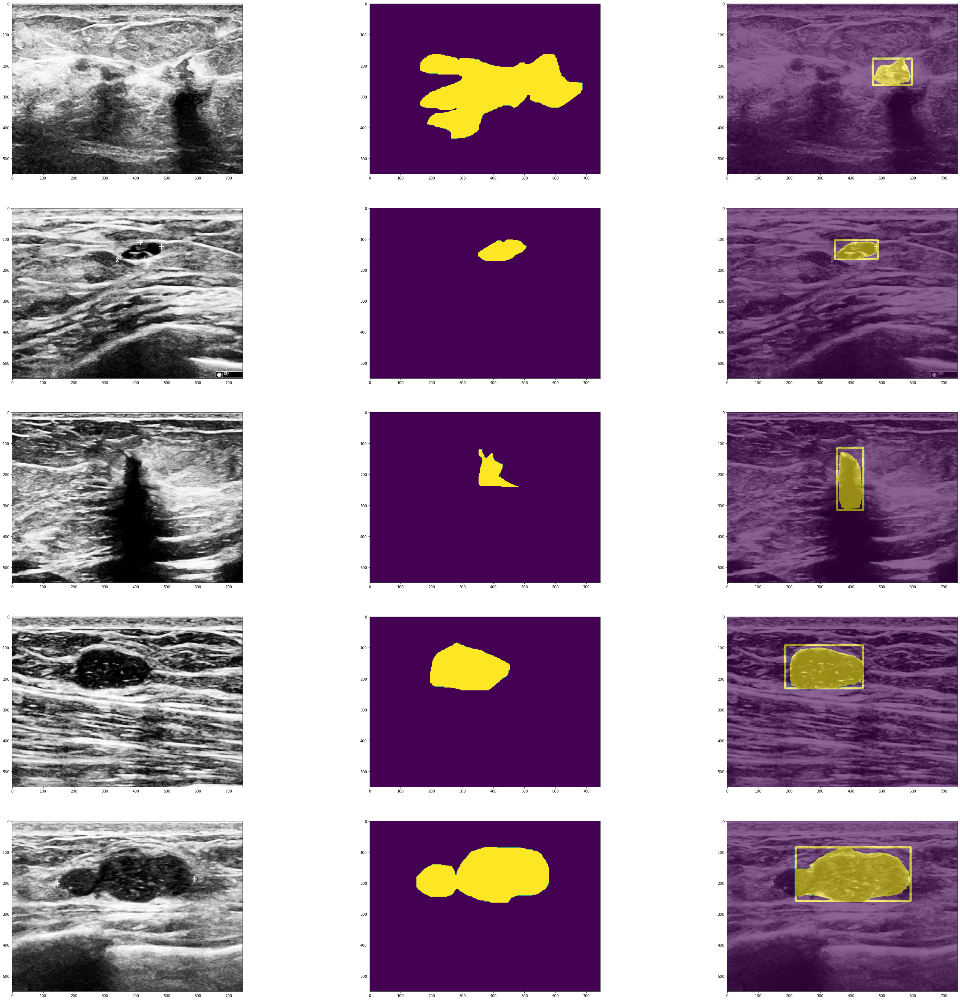

In [ ]:
plt.figure(figsize=(200, 100)) 
f, axarr = plt.subplots(5,3, figsize=(50,50))


image_names = sorted(glob.glob('/content/BUS/MyDrive/BUS/new_dataset2/segmentation/test/mask/*.png'))

for idx, iidx in enumerate(range(35,40)):

  gt_mask = cv.imread(image_names[iidx],0)

  img, mask = dataset_test[iidx]
  # put the model in evaluation mode
  model.eval()
  with torch.no_grad():
      prediction = model([img.to(device)])

  img2 = Image.fromarray(img.mul(255).permute(1, 2, 0).byte().numpy())
  gt_mask = Image.fromarray(gt_mask)
  # np_mask = prediction[0]['masks'][0, 0].mul(255).byte().cpu().numpy()
  np_mask = (prediction[0]['masks'][0, 0]>0.5).mul(255).byte().cpu().numpy()
  x1 = int(prediction[0]['boxes'][0][0])
  y1 = int(prediction[0]['boxes'][0][1])
  x2 = int(prediction[0]['boxes'][0][2])
  y2 = int(prediction[0]['boxes'][0][3])
  box = cv.rectangle(np_mask,(x1,y1),(x2,y2),(255,0,0),5)
  mask2 = Image.fromarray(box)


  axarr[idx, 0].imshow(img2)
  axarr[idx, 1].imshow(gt_mask)
  axarr[idx, 2].imshow(img2)
  axarr[idx, 2].imshow(mask2, alpha=0.6)

## Generate mask using mask rcnn model

In [ ]:
! mkdir /content/BUS/MyDrive/BUS/new_dataset2/segmentation/benign/
! mkdir /content/BUS/MyDrive/BUS/new_dataset2/segmentation/benign/image/
! mkdir /content/BUS/MyDrive/BUS/new_dataset2/segmentation/benign/mask/
! mkdir /content/BUS/MyDrive/BUS/new_dataset2/segmentation/benign/pmask/

! mkdir /content/BUS/MyDrive/BUS/new_dataset2/segmentation/malignant/
! mkdir /content/BUS/MyDrive/BUS/new_dataset2/segmentation/malignant/image/
! mkdir /content/BUS/MyDrive/BUS/new_dataset2/segmentation/malignant/mask/
! mkdir /content/BUS/MyDrive/BUS/new_dataset2/segmentation/malignant/pmask/

In [ ]:
! cp /content/BUS/MyDrive/BUS/new_dataset2/msk_class/test/benign/* /content/BUS/MyDrive/BUS/new_dataset2/segmentation/benign/mask/
! cp /content/BUS/MyDrive/BUS/new_dataset2/img_class/test/benign/* /content/BUS/MyDrive/BUS/new_dataset2/segmentation/benign/image/

! cp /content/BUS/MyDrive/BUS/new_dataset2/msk_class/test/malignant/* /content/BUS/MyDrive/BUS/new_dataset2/segmentation/malignant/mask/
! cp /content/BUS/MyDrive/BUS/new_dataset2/img_class/test/malignant/* /content/BUS/MyDrive/BUS/new_dataset2/segmentation/malignant/image/


### create mask for benign images

In [ ]:
# def main():
# train on the GPU or on the CPU, if a GPU is not available
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

# three classes - background, benign and malignant
num_classes = 3
# use our dataset and defined transformations
# use our dataset and defined transformations
# train_path = '/content/BUS/MyDrive/BUS/new_dataset2/train/malignant'
test_path = '/content/BUS/MyDrive/BUS/new_dataset2/segmentation/benign/'

# dataset = TumorDataset(train_path, get_transform(train=True), 'malignant')
dataset_test = TumorDataset(test_path, get_transform(train=False))

data_loader_test = torch.utils.data.DataLoader(
    dataset_test, batch_size=1, shuffle=False, num_workers=4,
    collate_fn=utils.collate_fn)

In [ ]:
len(data_loader_test)

33

In [ ]:
image_names = sorted(glob.glob('/content/BUS/MyDrive/BUS/new_dataset2/segmentation/benign/mask/*.png'))


for idx in range(len(data_loader_test)):
  file_name = str(image_names[idx]).split('/')[-1]

  # print(file_name)
  img, mask = dataset_test[idx]
  # put the model in evaluation mode
  model.eval()
  with torch.no_grad():
      prediction = model([img.to(device)])

  np_mask = (prediction[0]['masks'][0, 0]>0.5).mul(255).byte().cpu().numpy()

  img = Image.fromarray(np_mask)

  img.save(f'/content/BUS/MyDrive/BUS/new_dataset2/segmentation/benign/pmask/{file_name}')

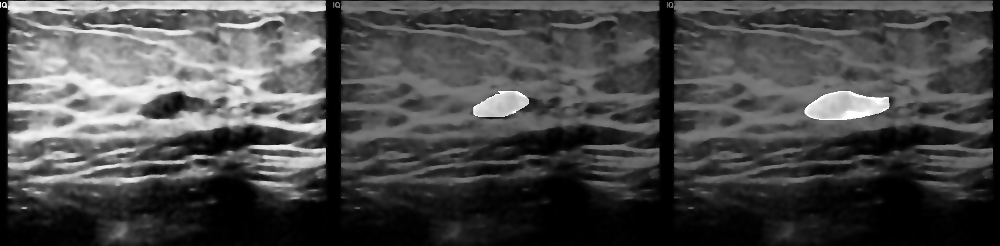

In [ ]:
mask = cv.imread('/content/BUS/MyDrive/BUS/new_dataset2/segmentation/benign/mask/546123474_long_mask.png',0)
img = cv.imread('/content/BUS/MyDrive/BUS/new_dataset2/segmentation/benign/image/546123474_long.png',0)
pmask = cv.imread('/content/BUS/MyDrive/BUS/new_dataset2/segmentation/benign/pmask/546123474_long_mask.png',0)


gr_overlay = cv.addWeighted(img, 0.5, mask, 0.7, 0)
pred_overlay = cv.addWeighted(img, 0.5, pmask, 0.7, 0)
res = np.hstack((img,gr_overlay,pred_overlay)) #stacking images side-by-side
cv2_imshow(res);

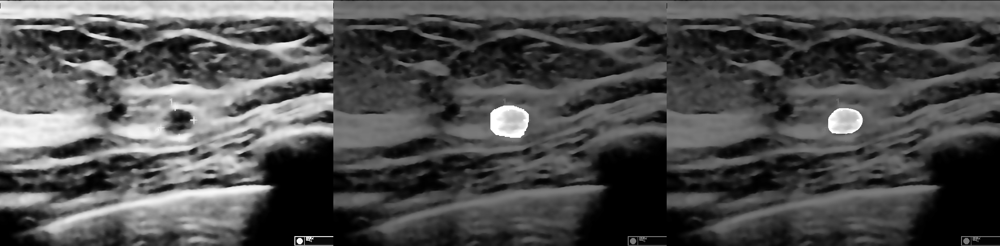

In [ ]:
mask = cv.imread('/content/BUS/MyDrive/BUS/new_dataset2/segmentation/benign/mask/349175531_tran_mask.png',0)
img = cv.imread('/content/BUS/MyDrive/BUS/new_dataset2/segmentation/benign/image/349175531_tran.png',0)
pmask = cv.imread('/content/BUS/MyDrive/BUS/new_dataset2/segmentation/benign/pmask/349175531_tran_mask.png',0)

gr_overlay = cv.addWeighted(img, 0.5, mask, 0.7, 0)
pred_overlay = cv.addWeighted(img, 0.5, pmask, 0.7, 0)
res = np.hstack((img,gr_overlay,pred_overlay)) #stacking images side-by-side
cv2_imshow(res);

### Create mask for malignant images

In [ ]:
# def main():
# train on the GPU or on the CPU, if a GPU is not available
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

# three classes - background, benign and malignant
num_classes = 3
# use our dataset and defined transformations
# use our dataset and defined transformations
# train_path = '/content/BUS/MyDrive/BUS/new_dataset2/train/malignant'
test_path = '/content/BUS/MyDrive/BUS/new_dataset2/segmentation/malignant/'

# dataset = TumorDataset(train_path, get_transform(train=True), 'malignant')
dataset_test = TumorDataset(test_path, get_transform(train=False))

data_loader_test = torch.utils.data.DataLoader(
    dataset_test, batch_size=1, shuffle=False, num_workers=4,
    collate_fn=utils.collate_fn)

In [ ]:
image_names = sorted(glob.glob('/content/BUS/MyDrive/BUS/new_dataset2/segmentation/malignant/mask/*.png'))


for idx in range(len(data_loader_test)):
  print(image_names[idx])
  file_name = str(image_names[idx]).split('/')[-1]

  # print(file_name)
  img, mask = dataset_test[idx]
  # put the model in evaluation mode
  model.eval()
  with torch.no_grad():
      prediction = model([img.to(device)])

  print(prediction)

  np_mask = (prediction[0]['masks'][0, 0]>0.5).mul(255).byte().cpu().numpy()

  img = Image.fromarray(np_mask)

  img.save(f'/content/BUS/MyDrive/BUS/new_dataset2/segmentation/malignant/pmask/{file_name}')

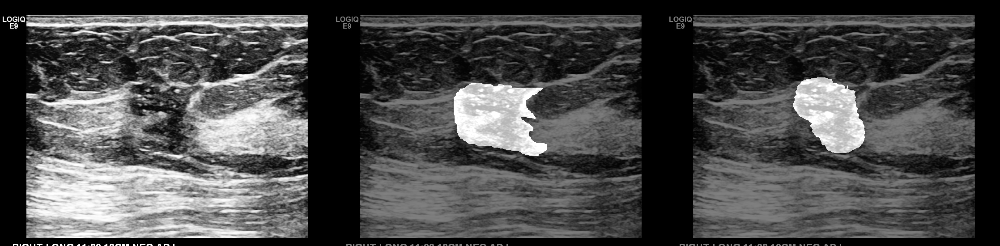

In [ ]:
mask = cv.imread('/content/BUS/MyDrive/BUS/new_dataset2/segmentation/malignant/mask/405112997_long_mask.png',0)
img = cv.imread('/content/BUS/MyDrive/BUS/new_dataset2/segmentation/malignant/image/405112997_long.png',0)
pmask = cv.imread('/content/BUS/MyDrive/BUS/new_dataset2/segmentation/malignant/pmask/405112997_long_mask.png',0)


gr_overlay = cv.addWeighted(img, 0.5, mask, 0.7, 0)
pred_overlay = cv.addWeighted(img, 0.5, pmask, 0.7, 0)
res = np.hstack((img,gr_overlay,pred_overlay)) #stacking images side-by-side
cv2_imshow(res);

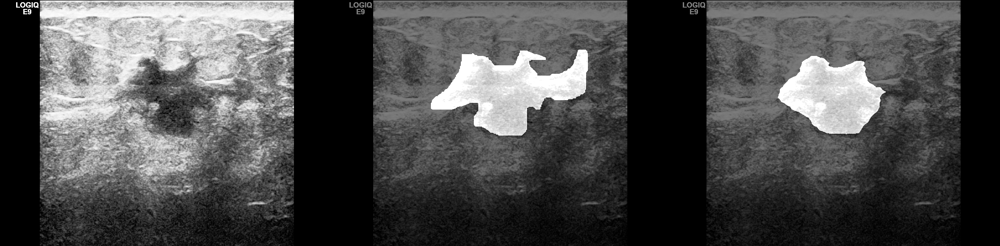

In [ ]:


mask = cv.imread('/content/BUS/MyDrive/BUS/new_dataset2/segmentation/malignant/mask/483851799_tran_mask.png',0)
img = cv.imread('/content/BUS/MyDrive/BUS/new_dataset2/segmentation/malignant/image/483851799_tran.png',0)
pmask = cv.imread('/content/BUS/MyDrive/BUS/new_dataset2/segmentation/malignant/pmask/483851799_tran_mask.png',0)


gr_overlay = cv.addWeighted(img, 0.5, mask, 0.7, 0)
pred_overlay = cv.addWeighted(img, 0.5, pmask, 0.7, 0)
res = np.hstack((img,gr_overlay,pred_overlay)) #stacking images side-by-side
cv2_imshow(res);

# Classification model

## Train and test on ground truth Mask

In [ ]:
from torchvision import models, datasets, transforms
import torch

### Define transformations

In [ ]:
train_transform = transforms.Compose([
                                     transforms.Resize(size=256),
                                     transforms.CenterCrop(size=224),
                                     transforms.ToTensor(),
                                     transforms.Normalize(mean=[0.485, 0.456, 0.406], 
                                                          std=[0.229, 0.224, 0.225])
                                     

])

### Define dataset and data loader

In [ ]:
train_dataset = datasets.ImageFolder('/content/BUS/MyDrive/BUS/new_dataset2/msk_class/train',
                                     transform=train_transform)

test_dataset = datasets.ImageFolder('/content/BUS/MyDrive/BUS/new_dataset2/msk_class/test',
                                     transform=train_transform)

In [ ]:
batch_size = 10

train_loader = torch.utils.data.DataLoader(train_dataset,
                                           batch_size=batch_size,
                                           shuffle=True)

test_loader = torch.utils.data.DataLoader(test_dataset,
                                           batch_size=batch_size)

### Get pre-trained model

In [ ]:
model_class = models.vgg16(pretrained=True)

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth


  0%|          | 0.00/528M [00:00<?, ?B/s]

### Freeze the weights of the model

In [ ]:
for param in model_class.parameters():
    param.requires_grad = False

### Define the classification layer

In [ ]:
model_class.classifier = nn.Sequential(nn.Linear(25088, 4096),
                                 nn.ReLU(),
                                 nn.Dropout(0.5),
                                 nn.Linear(4096, 4096),
                                 nn.ReLU(),
                                 nn.Dropout(0.5),
                                 nn.Linear(4096, 1024),
                                 nn.ReLU(),
                                 nn.Dropout(0.5),
                                 nn.Linear(1024, 3),
                                 nn.LogSoftmax(dim=1))

In [ ]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)
model_class.to(device)

cuda:0


VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

### Optimizer and loss function

In [ ]:
# Loss and optimizer:
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model_class.parameters())

### Model training

In [ ]:
from tqdm import tqdm
from datetime import datetime

def batch_gd(model, criterion, optimizer, train_loader, test_loader, epochs=25, min_test_accuracy=1.0):
    train_losses = np.zeros(epochs)
    test_losses = np.zeros(epochs)
    train_accuracy = np.zeros(epochs)
    test_accuracy = np.zeros(epochs)
    max_accuracy = min_test_accuracy


    for it in range(epochs):
        t0 = datetime.now()

        # print('Training ...')
        train_loss = []
        trn_corr = 0
        cnt = 0
        for inputs, targets in tqdm(train_loader):
            cnt += len(inputs)
            # print('assign device')
            inputs, targets = inputs.to(device), targets.to(device)

            # print('Zero gradient')
            optimizer.zero_grad()

            # print('Shape:' + str(inputs.shape))
            outputs = model(inputs)
            loss = criterion(outputs, targets)

            predicted = torch.max(outputs.data, 1)[1]
            batch_corr = (predicted == targets).sum()
            trn_corr += batch_corr
#             print(f'predicted: {predicted}')
#             print(f'targets: {targets}')
            
            # print('Backpropogation and optimization')
            loss.backward()
            optimizer.step()

            train_loss.append(loss.item())

#         print(f'predicted: {predicted}')
#         print(f'batch_corr: {batch_corr}')
#         print(f'cnt: {cnt}')
        train_loss_mean = np.mean(train_loss)
        train_accuracy[it] = float(trn_corr) / cnt

        # print('Test ...')
        test_loss = []
        test_corr = 0
        cnt = 0

        with torch.no_grad():
            for inputs, targets in tqdm(test_loader):
                cnt += len(inputs)
                inputs, targets = inputs.to(device), targets.to(device)
                outputs = model(inputs)
                loss = criterion(outputs, targets)

                predicted = torch.max(outputs.data, 1)[1]
                batch_corr = (predicted == targets).sum()
                test_corr += batch_corr
                

                test_loss.append(loss.item())

        test_loss_mean = np.mean(test_loss)
        test_accuracy[it] = float(test_corr)/ cnt

        train_losses[it] = train_loss_mean
        test_losses[it] = test_loss_mean

        dt = datetime.now() - t0

        # print(f"""Epoch {it + 1} /{epochs}, 
        #         Train loss: {train_loss_mean:.4f}
        #         Test Loss: {test_loss_mean:.4f}, 
        #         Train accuracy: {train_accuracy[it]}
        #         Test accuracy: {test_accuracy[it]},
        #         Duration: {dt} """)

        if test_accuracy[it] > max_accuracy:
            max_accuracy = test_accuracy[it]
            print(f'Saving the model parameter: Epoch {it + 1} Test accuracy: {max_accuracy}')
            str_ts = datetime.strftime(datetime.now(), '%Y%m%d%H%M')
            checkpoint = {'model_state': model.state_dict(), 
                          'optimizer_state': optimizer.state_dict()}
            
            torch.save(checkpoint, f'/content/BUS/MyDrive/BUS/checkpoint/vgg_checkpoint_epoch_{it+1}_{str_ts}.pt')

    return train_losses, test_losses, train_accuracy, test_accuracy

In [ ]:
train_losses, test_losses, train_accuracy, test_accuracy = batch_gd(model_class,
                                                                    criterion,
                                                                    optimizer,
                                                                    train_loader,
                                                                    test_loader,
                                                                    epochs=25,
                                                                    min_test_accuracy=0.7)

100%|██████████| 7/7 [00:00<00:00,  9.01it/s]


Saving the model parameter: Epoch 13 Test accuracy: 0.7142857142857143


100%|██████████| 7/7 [00:00<00:00,  9.22it/s]


### Loss plot

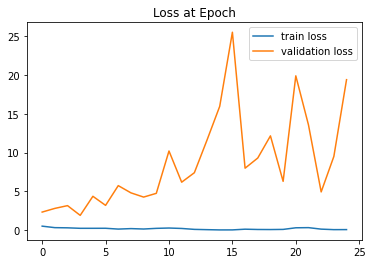

In [ ]:
plt.plot(train_losses, label='train loss')
plt.plot(test_losses, label='validation loss')
plt.title('Loss at Epoch')
plt.legend()

### Accuracy plot

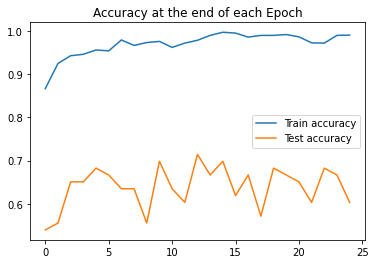

In [ ]:
plt.plot(train_accuracy, label='Train accuracy')
plt.plot(test_accuracy, label='Test accuracy')
plt.title('Accuracy at the end of each Epoch')
plt.legend()

In [ ]:
np.sort(test_accuracy)

array([0.53968254, 0.55555556, 0.55555556, 0.57142857, 0.6031746 ,
       0.6031746 , 0.6031746 , 0.61904762, 0.63492063, 0.63492063,
       0.63492063, 0.65079365, 0.65079365, 0.65079365, 0.66666667,
       0.66666667, 0.66666667, 0.66666667, 0.66666667, 0.68253968,
       0.68253968, 0.68253968, 0.6984127 , 0.6984127 , 0.71428571])

### Confusion Matrix

In [ ]:
# device = torch.device("cpu")
# model.to(device)
y_true = []
y_pred = []

model_state = torch.load('/content/BUS/MyDrive/BUS/checkpoint/vgg_checkpoint_epoch_21_202204170938.pt')['model_state']
model_class.load_state_dict(model_state, strict=True)

for inputs, targets in test_loader:
    inputs, targets = inputs.to(device), targets.to(device)
    # print(inputs.shape)

    outputs = model_class(inputs)  
    predicted = torch.max(outputs.data, 1)[1]

    y_true.extend(targets.tolist())
    y_pred.extend(predicted.tolist())
    # print(f'target: {targets}, predicted: {predicted}')

print('\n\nConfusion Matrix')
pd.DataFrame(confusion_matrix(y_true, y_pred), index=['Benign', 'Malignant'], columns=['Benign', 'Malignant'])



Confusion Matrix


,Benign,Malignant
Benign,31,2
Malignant,6,24


In [ ]:
print(f'Accuracy: {(31 + 24) / 63}')

Accuracy: 0.873015873015873


## Test on predicted mask

In [ ]:
! mkdir /content/BUS/MyDrive/BUS/new_dataset2/msk_class/test_pmask
! mkdir /content/BUS/MyDrive/BUS/new_dataset2/msk_class/test_pmask/benign
! mkdir /content/BUS/MyDrive/BUS/new_dataset2/msk_class/test_pmask/malignant

! cp /content/BUS/MyDrive/BUS/new_dataset2/segmentation/malignant/pmask/* /content/BUS/MyDrive/BUS/new_dataset2/msk_class/test_pmask/malignant/
! cp /content/BUS/MyDrive/BUS/new_dataset2/segmentation/benign/pmask/* /content/BUS/MyDrive/BUS/new_dataset2/msk_class/test_pmask/benign/


mkdir: cannot create directory ‘/content/BUS/MyDrive/BUS/new_dataset2/msk_class/test_pmask’: File exists
mkdir: cannot create directory ‘/content/BUS/MyDrive/BUS/new_dataset2/msk_class/test_pmask/benign’: File exists
mkdir: cannot create directory ‘/content/BUS/MyDrive/BUS/new_dataset2/msk_class/test_pmask/malignant’: File exists


### Define the test dataset

In [ ]:
test_dataset = datasets.ImageFolder('/content/BUS/MyDrive/BUS/new_dataset2/msk_class/test_pmask',
                                     transform=train_transform)

In [ ]:
batch_size = 10

test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size)

### Confusion Matrix

In [ ]:
# device = torch.device("cpu")
# model.to(device)
y_true = []
y_pred = []

# /content/BUS/MyDrive/BUS/checkpoint/vgg_checkpoint_epoch_21_202204170938.pt
# /content/BUS/MyDrive/BUS/checkpoint/vgg_checkpoint_epoch_13_202204241132.pt
model_state = torch.load('/content/BUS/MyDrive/BUS/checkpoint/vgg_checkpoint_epoch_21_202204170938.pt')['model_state']
model_class.load_state_dict(model_state, strict=True)

for inputs, targets in test_loader:
    inputs, targets = inputs.to(device), targets.to(device)
    # print(inputs.shape)

    outputs = model_class(inputs)  
    predicted = torch.max(outputs.data, 1)[1]

    y_true.extend(targets.tolist())
    y_pred.extend(predicted.tolist())
    # print(f'target: {targets}, predicted: {predicted}')

print('\n\nConfusion Matrix')
pd.DataFrame(confusion_matrix(y_true, y_pred), index=['Benign', 'Malignant'], columns=['Benign', 'Malignant'])



Confusion Matrix


,Benign,Malignant
Benign,28,5
Malignant,9,20


In [ ]:
print(f'Accuracy: {(28 + 20) / 62}')

Accuracy: 0.7741935483870968


Accuracy: 63.5%

## Train and test on utrasound Images


In [ ]:
from torchvision import models, datasets, transforms
import torch

### Define Transformation

In [ ]:
train_transform = transforms.Compose([
                                     transforms.Resize(size=256),
                                     transforms.CenterCrop(size=224),
                                     transforms.ToTensor(),
                                     transforms.Normalize(mean=[0.485, 0.456, 0.406], 
                                                          std=[0.229, 0.224, 0.225])
                                     

])

### Define data set and data loader

In [ ]:
train_dataset = datasets.ImageFolder('/content/BUS/MyDrive/BUS/new_dataset2/img_class/train',
                                     transform=train_transform)

test_dataset = datasets.ImageFolder('/content/BUS/MyDrive/BUS/new_dataset2/img_class/test',
                                     transform=train_transform)

In [ ]:
batch_size = 10

train_loader = torch.utils.data.DataLoader(train_dataset,
                                           batch_size=batch_size,
                                           shuffle=True)

test_loader = torch.utils.data.DataLoader(test_dataset,
                                           batch_size=batch_size)

### Get pre-trained model

In [ ]:
model_class = models.vgg16(pretrained=True)

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth


  0%|          | 0.00/528M [00:00<?, ?B/s]

### Freeze the weights of the model

In [ ]:
for param in model_class.parameters():
    param.requires_grad = False

### Define the classification layer

In [ ]:
model_class.classifier = nn.Sequential(nn.Linear(25088, 4096),
                                 nn.ReLU(),
                                 nn.Dropout(0.5),
                                 nn.Linear(4096, 4096),
                                 nn.ReLU(),
                                 nn.Dropout(0.5),
                                 nn.Linear(4096, 1024),
                                 nn.ReLU(),
                                 nn.Dropout(0.5),
                                 nn.Linear(1024, 3),
                                 nn.LogSoftmax(dim=1))

In [ ]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)
model_class.to(device)

cuda:0


VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

### Loss and Optimizer

In [ ]:
# Loss and optimizer:
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model_class.parameters())

### Train the model

In [ ]:
from tqdm import tqdm
from datetime import datetime

def batch_gd(model, criterion, optimizer, train_loader, test_loader, epochs=25, min_test_accuracy=1.0):
    train_losses = np.zeros(epochs)
    test_losses = np.zeros(epochs)
    train_accuracy = np.zeros(epochs)
    test_accuracy = np.zeros(epochs)
    max_accuracy = min_test_accuracy


    for it in range(epochs):
        t0 = datetime.now()

        # print('Training ...')
        train_loss = []
        trn_corr = 0
        cnt = 0
        for inputs, targets in tqdm(train_loader):
            cnt += len(inputs)
            # print('assign device')
            inputs, targets = inputs.to(device), targets.to(device)

            # print('Zero gradient')
            optimizer.zero_grad()

            # print('Shape:' + str(inputs.shape))
            outputs = model(inputs)
            loss = criterion(outputs, targets)

            predicted = torch.max(outputs.data, 1)[1]
            batch_corr = (predicted == targets).sum()
            trn_corr += batch_corr
#             print(f'predicted: {predicted}')
#             print(f'targets: {targets}')
            
            # print('Backpropogation and optimization')
            loss.backward()
            optimizer.step()

            train_loss.append(loss.item())

#         print(f'predicted: {predicted}')
#         print(f'batch_corr: {batch_corr}')
#         print(f'cnt: {cnt}')
        train_loss_mean = np.mean(train_loss)
        train_accuracy[it] = float(trn_corr) / cnt

        # print('Test ...')
        test_loss = []
        test_corr = 0
        cnt = 0

        with torch.no_grad():
            for inputs, targets in tqdm(test_loader):
                cnt += len(inputs)
                inputs, targets = inputs.to(device), targets.to(device)
                outputs = model(inputs)
                loss = criterion(outputs, targets)

                predicted = torch.max(outputs.data, 1)[1]
                batch_corr = (predicted == targets).sum()
                test_corr += batch_corr
                

                test_loss.append(loss.item())

        test_loss_mean = np.mean(test_loss)
        test_accuracy[it] = float(test_corr)/ cnt

        train_losses[it] = train_loss_mean
        test_losses[it] = test_loss_mean

        dt = datetime.now() - t0

        # print(f"""Epoch {it + 1} /{epochs}, 
        #         Train loss: {train_loss_mean:.4f}
        #         Test Loss: {test_loss_mean:.4f}, 
        #         Train accuracy: {train_accuracy[it]}
        #         Test accuracy: {test_accuracy[it]},
        #         Duration: {dt} """)

        if test_accuracy[it] > max_accuracy:
            max_accuracy = test_accuracy[it]
            print(f'Saving the model parameter: Epoch {it + 1} Test accuracy: {max_accuracy}')
            str_ts = datetime.strftime(datetime.now(), '%Y%m%d%H%M')
            checkpoint = {'model_state': model.state_dict(), 
                          'optimizer_state': optimizer.state_dict()}
            
            torch.save(checkpoint, f'/content/BUS/MyDrive/BUS/checkpoint/vgg_checkpoint_epoch_img_{it+1}_{str_ts}.pt')

    return train_losses, test_losses, train_accuracy, test_accuracy

In [ ]:
train_losses, test_losses, train_accuracy, test_accuracy = batch_gd(model_class,
                                                                    criterion,
                                                                    optimizer,
                                                                    train_loader,
                                                                    test_loader,
                                                                    epochs=25,
                                                                    min_test_accuracy=0.65)

100%|██████████| 7/7 [00:00<00:00,  7.51it/s]


### Loss plot

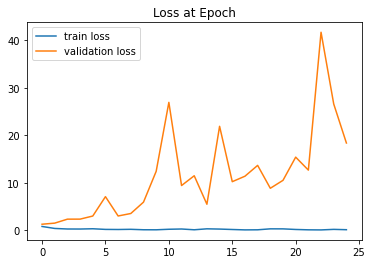

In [ ]:
plt.plot(train_losses, label='train loss')
plt.plot(test_losses, label='validation loss')
plt.title('Loss at Epoch')
plt.legend()

### Accuracy plot

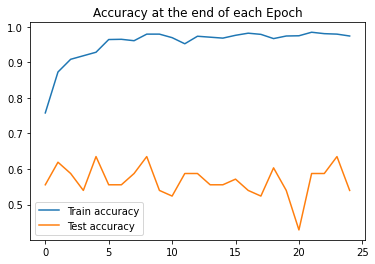

In [ ]:
plt.plot(train_accuracy, label='Train accuracy')
plt.plot(test_accuracy, label='Test accuracy')
plt.title('Accuracy at the end of each Epoch')
plt.legend()

In [ ]:
np.sort(test_accuracy)

array([0.42857143, 0.52380952, 0.52380952, 0.53968254, 0.53968254,
       0.53968254, 0.53968254, 0.53968254, 0.55555556, 0.55555556,
       0.55555556, 0.55555556, 0.55555556, 0.57142857, 0.58730159,
       0.58730159, 0.58730159, 0.58730159, 0.58730159, 0.58730159,
       0.6031746 , 0.61904762, 0.63492063, 0.63492063, 0.63492063])

### Confusion Matrix

In [ ]:
# device = torch.device("cpu")
# model.to(device)
y_true = []
y_pred = []

model_state = torch.load('/content/BUS/MyDrive/BUS/checkpoint/vgg_checkpoint_epoch_img_22_202204170104.pt')['model_state']
model_class.load_state_dict(model_state, strict=True)

for inputs, targets in test_loader:
    inputs, targets = inputs.to(device), targets.to(device)
    print(inputs.shape)

    outputs = model_class(inputs)  
    # print(outputs.data)
    # exit
    predicted = torch.max(outputs.data, 1)[1]

    y_true.extend(targets.tolist())
    y_pred.extend(predicted.tolist())
    # print(f'target: {targets}, predicted: {predicted}')

print('\n\nConfusion Matrix')
pd.DataFrame(confusion_matrix(y_true, y_pred), index=['Benign', 'Malignant'], columns=['Benign', 'Malignant'])

torch.Size([10, 3, 224, 224])
torch.Size([10, 3, 224, 224])
torch.Size([10, 3, 224, 224])
torch.Size([10, 3, 224, 224])
torch.Size([10, 3, 224, 224])
torch.Size([10, 3, 224, 224])
torch.Size([3, 3, 224, 224])


Confusion Matrix


,Benign,Malignant
Benign,31,2
Malignant,13,17


In [ ]:
print(f'Accuracy: {(30 + 19) / 63}')

Accuracy: 0.7777777777777778


Accuracy: 61.53 %